GLM analysis of working memory training fMRI data
=====================================================

Supplementary analysis - standard GLM analysis of activation patterns changes between 1-back to 2-back. 

First level dual n-back task GLM analysis performed for each subject and session. 
- contrast of interest: 2-back vs. 1-back (two-sided)
- included confounds regressors analogical to functional connetivity analysis (aCompCor, 24 motion parameters, outlier scans)

Outputs:
- z-maps for each subject and session
- group 3D array (subjects x sessions x ROIs) representing mean z-score values extracted from 264 Power ROIs coordinates (Power et al., 2012) for 2-back vs. 1-back contrast

In [2]:
import sys
sys.path.append("..")

import os
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

import nibabel as nib
from nilearn import input_data, datasets
from nilearn.plotting import plot_stat_map, plot_anat, plot_img, show, plot_glass_brain
from nistats.first_level_model import FirstLevelModel
from nistats.reporting import plot_design_matrix, plot_contrast_matrix
from nistats.design_matrix import make_first_level_design_matrix

from fctools import denoise

Setup
--------------------

In [3]:
subjects_data = pd.read_csv('../data/behavioral/group_assignment.csv')
subjects_data_clean = subjects_data[subjects_data['group'].isin(['Experimental', 'Control'])].reset_index()

subjects = subjects_data_clean['sub']
sessions = ['ses-1', 'ses-2', 'ses-3', 'ses-4']

data_dir = '/media/finc/Elements/LearningBrain_fmriprep/'
out_dir = '/media/finc/Elements/LearningBrain_fmriprep_GLM/'
suffix = 'task-dualnback_bold_space-MNI152NLin2009cAsym_preproc'

# Load task-block onsets
events = pd.read_csv('../support/onsets_dualnback.csv')

# Setup GLM model
fmri_glm = FirstLevelModel(
    t_r=2,   
    noise_model='ar1',
    drift_model='cosine',
    high_pass=0.008,
    standardize=False,
    hrf_model='glover',
    smoothing_fwhm=6)


# Loading Power ROIs coordinates
power = datasets.fetch_coords_power_2011()
power_coords = np.vstack((power.rois['x'], power.rois['y'], power.rois['z'])).T

# Creating masker file
power_maps = input_data.NiftiSpheresMasker(
    seeds = power_coords, 
    radius = 5,
)

n_rois = len(power_coords)

First level GLM analysis
-----------------------------------

/home/finc/anaconda3/lib/python3.7/site-packages/nistats/utils.py:276: UserWarning: Matrix is singular at working precision, regularizing...
  warn('Matrix is singular at working precision, regularizing...')
/home/finc/anaconda3/lib/python3.7/site-packages/nistats/utils.py:276: UserWarning: Matrix is singular at working precision, regularizing...
  warn('Matrix is singular at working precision, regularizing...')
/home/finc/anaconda3/lib/python3.7/site-packages/nistats/utils.py:276: UserWarning: Matrix is singular at working precision, regularizing...
  warn('Matrix is singular at working precision, regularizing...')
/home/finc/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarni

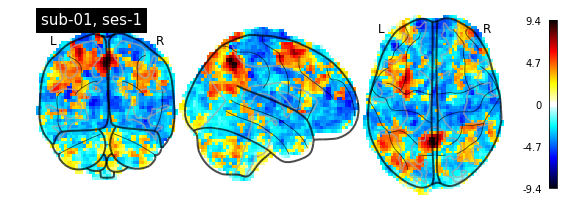

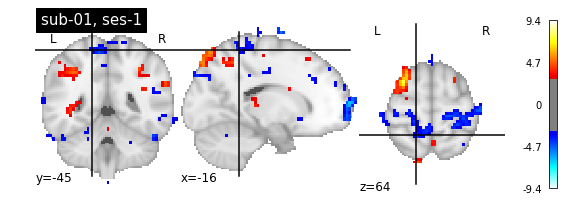

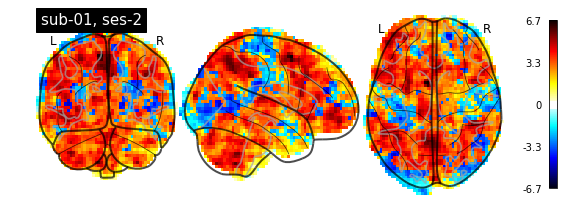

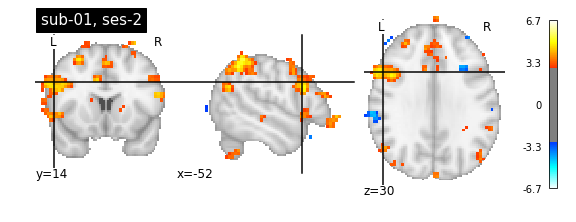

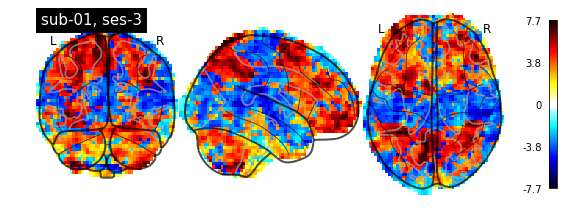

...

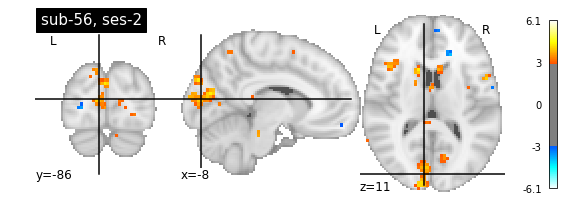

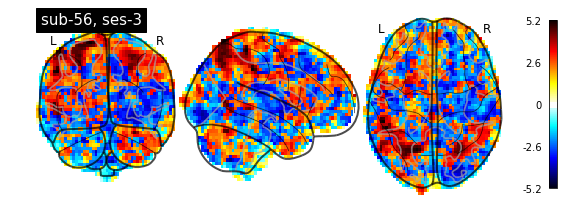

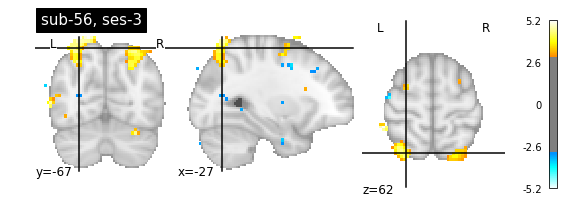

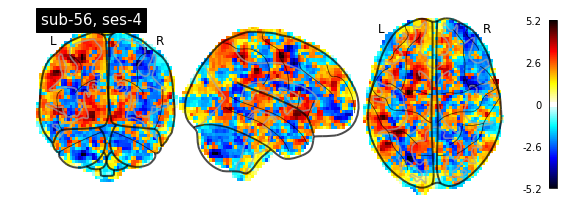

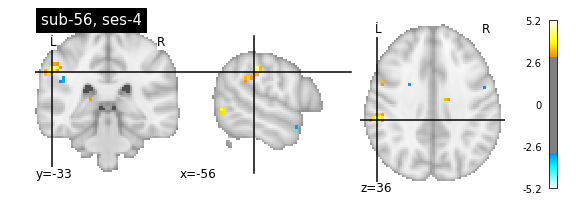

In [4]:
timeseries = np.zeros((len(subjects), len(sessions), n_rois))

for i, sub in enumerate(subjects):
    for j, ses in enumerate(sessions):
        os.makedirs(f'{out_dir}{sub}/{ses}')
        fmri_img = f'{data_dir}{sub}/{ses}/func/{sub}_{ses}_{suffix}.nii.gz'
        confounds = pd.read_csv(f'{data_dir}{sub}/{ses}/func/{sub}_{ses}_task-dualnback_bold_confounds.tsv', delimiter='\t')
        fmri_mask = f'{data_dir}{sub}/{ses}/func/{sub}_{ses}_task-dualnback_bold_space-MNI152NLin2009cAsym_brainmask.nii.gz'
        
        # Selecting columns of interest 
        confounds_motion = confounds[confounds.filter(regex='X|Y|Z|RotX|RotY|RotZ').columns]
        confounds_acompcor = confounds[confounds.filter(regex='aCompCor').columns]
        confounds_scrub = confounds[confounds.filter(regex='vx-wisestdDVARS|Framewise').columns]

        # Calculating additional motion parameters (temporal derivatives + quadratic terms)
        confounds_motion_td = denoise.temp_deriv(confounds_motion, quadratic=True) # extended motion confounds

        # Detecting outliers 
        confounds_scrub_td = denoise.temp_deriv(denoise.outliers_fd_dvars(confounds_scrub, fd=0.5, dvars=3), quadratic=False)

        # Concatenating columns
        confounds_clean = pd.concat([confounds_acompcor, 
                                     confounds_motion_td, 
                                     confounds_scrub_td, 
                                    ], axis=1)


        fmri_glm.mask_img = nib.load(fmri_mask)
        fmri_glm = fmri_glm.fit(fmri_img, events, confounds=confounds_clean)
        design_matrix = fmri_glm.design_matrices_[0]

        # Setting-up conditions
        condition_1b = np.asarray([1 if i == '1-back' else 0 for i in design_matrix.columns])
        condition_2b = np.asarray([1 if i == '2-back' else 0 for i in design_matrix.columns])

        # Defining contrast 2-back - 1-back
        z_map = fmri_glm.compute_contrast(condition_2b-condition_1b, output_type='z_score')
        timeseries[i,j,:] = power_maps.fit_transform(z_map)

        # Saving z_maps
        nib.save(z_map, f'{out_dir}{sub}/{ses}/{sub}_{ses}_{suffix}_2b_minus_1b_zmap.nii.gz')
        
        g = plot_glass_brain(z_map, colorbar=True, plot_abs=False, title=f'{sub}, {ses}')
        g.savefig(f'{out_dir}{sub}/{ses}/{sub}_{ses}_{suffix}_2b_minus_1b_zmap_glass_brain.png')

        s = plot_stat_map(z_map, threshold=3, title=f'{sub}, {ses}')
        s.savefig(f'{out_dir}{sub}/{ses}/{sub}_{ses}_{suffix}_2b_minus_1b_zmap_slices.png')
        
np.save(f'{out_dir}GLM_power_2b_minus_1b_zmap_timeseries.npy', timeseries)

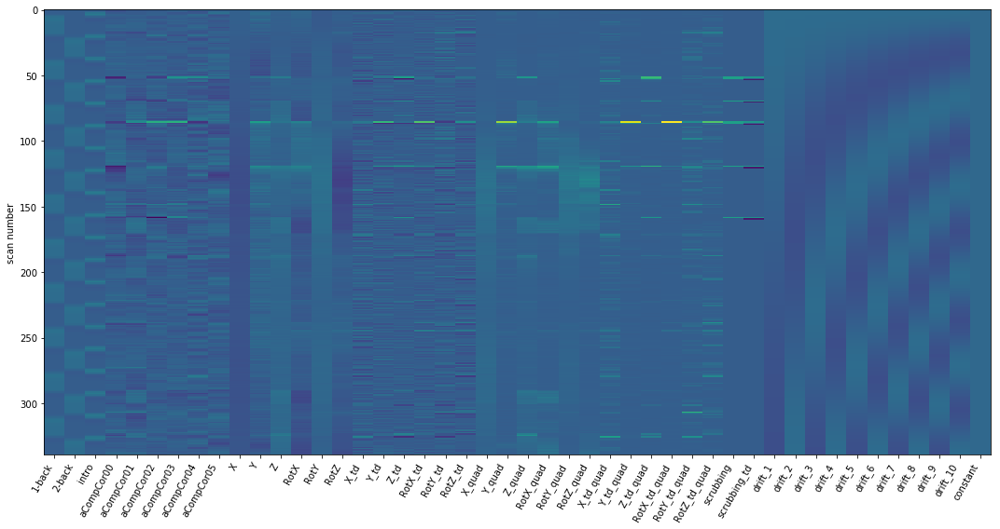

In [35]:
fig, ax = plt.subplots(figsize=(15,8))
d = plot_design_matrix(design_matrix, ax=ax)